# Bar Chart Race

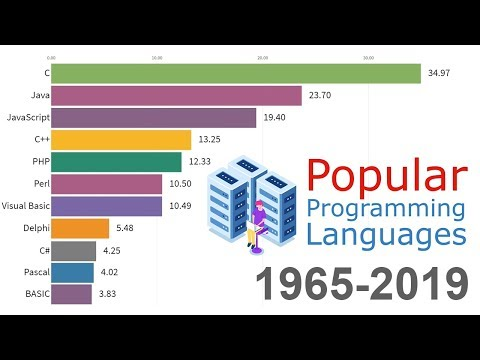

In [16]:
from IPython.display import YouTubeVideo

url="Og847HVwRSI"
YouTubeVideo(id=url,width=600,height=400)

In [7]:
# Importamos las librerías de animación de Matplotlib
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import matplotlib.animation as animation
from IPython.display import HTML

In [8]:
# Importamos el dataset
df = pd.read_csv('Datasets/Population.csv')
df.head(3)

,Unnamed: 0,name,group,year,value,subGroup,city_id,lastValue,lat,lon
0,0,Agra,India,1575,200.0,India,Agra - India,200.0,27.18333,78.01667
1,1,Agra,India,1576,212.0,India,Agra - India,200.0,27.18333,78.01667
2,2,Agra,India,1577,224.0,India,Agra - India,212.0,27.18333,78.01667


In [10]:
df.columns

Index(['Unnamed: 0', 'name', 'group', 'year', 'value', 'subGroup', 'city_id',
       'lastValue', 'lat', 'lon'],
      dtype='object')

In [11]:
# Eliminamos las columnas que no se van a ocupar
df.drop(['Unnamed: 0', 'subGroup', 'city_id', 'lastValue', 'lat', 'lon'],axis=1, inplace=True)
df.head(3)

,name,group,year,value
0,Agra,India,1575,200.0
1,Agra,India,1576,212.0
2,Agra,India,1577,224.0


In [12]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6252 entries, 0 to 6251
Data columns (total 4 columns):
name     6252 non-null object
group    6252 non-null object
year     6252 non-null int64
value    6252 non-null float64
dtypes: float64(1), int64(1), object(2)
memory usage: 195.5+ KB


In [17]:
df.year.max()

2020

In [39]:
# Creamos un filtro para poder ver los principales 10 valores de un año dado:

current_year = 2020

dff = (df[df.year==current_year])
dff = dff.sort_values(by='value', ascending=False)
dff = dff.head(10)
dff

,name,group,year,value
6047,Tokyo,Asia,2020,38323.0
1326,Delhi,India,2020,29348.0
5549,Shanghai,Asia,2020,27137.0
691,Beijing,Asia,2020,24201.0
3750,Mumbai,India,2020,22838.0
5447,Sao Paulo,Latin America,2020,22119.0
3576,Mexico City,Latin America,2020,21868.0
1338,Dhaka,Asia,2020,20989.0
1197,Cairo,Middle East,2020,20568.0
4681,Osaka,Asia,2020,20523.0


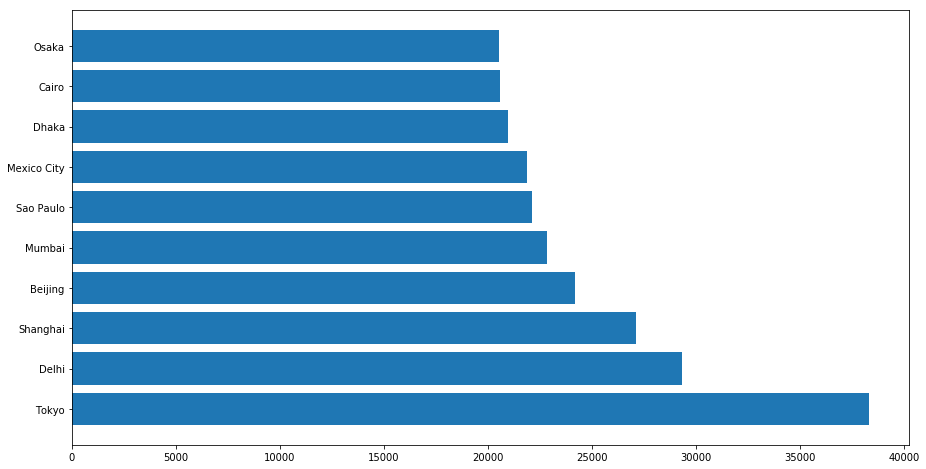

In [40]:
fig, ax = plt.subplots(figsize=(15, 8))
ax.barh(dff['name'], dff['value'])
plt.show()

In [41]:
dff = dff[::-1]   # Esta línea se debe ejecutar en caso de que los datos estén en orden inverso

In [42]:
regiones=['India', 'Europe', 'Asia', 'Latin America','Middle East', 'North America', 'Africa']
colores=['#adb0ff', '#ffb3ff', '#90d595', '#e48381','#aafbff', '#f7bb5f', '#eafb50']
colors = dict(zip(regiones,colores))    

In [43]:
group_lk = df.set_index('name')['group'].to_dict()
group_lk

{'Agra': 'India',
 'Ahmedabad': 'India',
 'Amsterdam': 'Europe',
 'Ayutthaya': 'Asia',
 'Beijing': 'Asia',
 'Berlin': 'Europe',
 'Bijapur': 'India',
 'Birmingham': 'Europe',
 'Boston': 'North America',
 'Buenos Aires': 'Latin America',
 'Cairo': 'Middle East',
 'Chicago': 'North America',
 'Cuttack': 'India',
 'Delhi': 'India',
 'Dhaka': 'Asia',
 'Edirne': 'Europe',
 'Esfahan': 'Middle East',
 'Fez': 'Middle East',
 'Gauda': 'India',
 'Guangzhou': 'Asia',
 'Hangzhou': 'Asia',
 'Istanbul': 'Europe',
 'Karachi': 'Asia',
 'Kolkatta': 'India',
 'Kyoto': 'Asia',
 'Lisbon': 'Europe',
 'London': 'Europe',
 'Los Angeles': 'North America',
 'Lucknow': 'India',
 'Manchester': 'Europe',
 'Mashhad': 'Middle East',
 'Mexico City': 'Latin America',
 'Moscow': 'Europe',
 'Mumbai': 'India',
 'Nanjing': 'Asia',
 'Naples': 'Europe',
 'New York': 'North America',
 'Osaka': 'Asia',
 'Paris': 'Europe',
 'Pegu': 'Asia',
 'Philadelphia': 'North America',
 'Rio de Janeiro': 'Latin America',
 'Saint Petersburg

Text(1, 0.4, '2020')

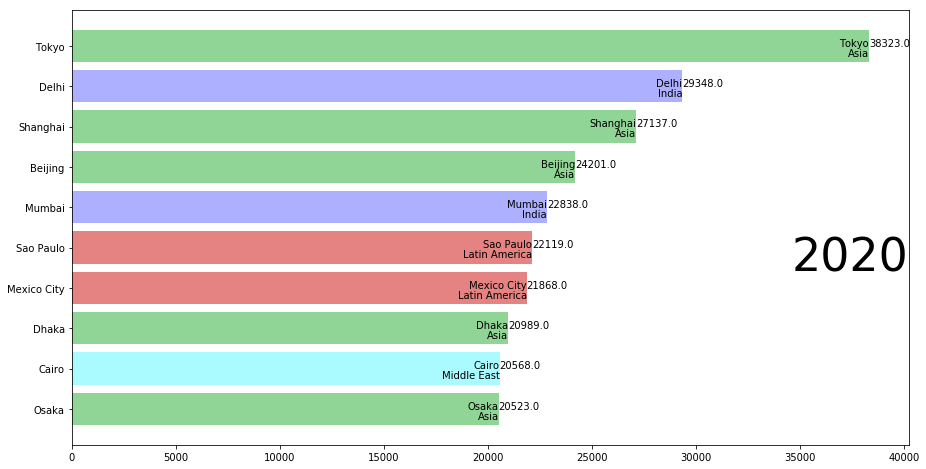

In [44]:
fig, ax = plt.subplots(figsize=(15, 8))
# Coloreamos las barras con el diccionario colors
ax.barh(dff['name'], dff['value'], color=[colors[group_lk[x]] for x in dff['name']])

# iterate sobre los valores para colocar etiquetas a las barras
for i, (value, name) in enumerate(zip(dff['value'], dff['name'])):
    ax.text(value, i,     name,            ha='right')  # Nombre de la ciduad
    ax.text(value, i-.25, group_lk[name],  ha='right')  # Nombre de la región
    ax.text(value, i,     value,           ha='left')   # Cantidad

# Agregamos una etiqueta del año justo a la mitad de la gráfica
ax.text(1, 0.4, current_year, transform=ax.transAxes, size=46, ha='right')

## Creando la función para graficar

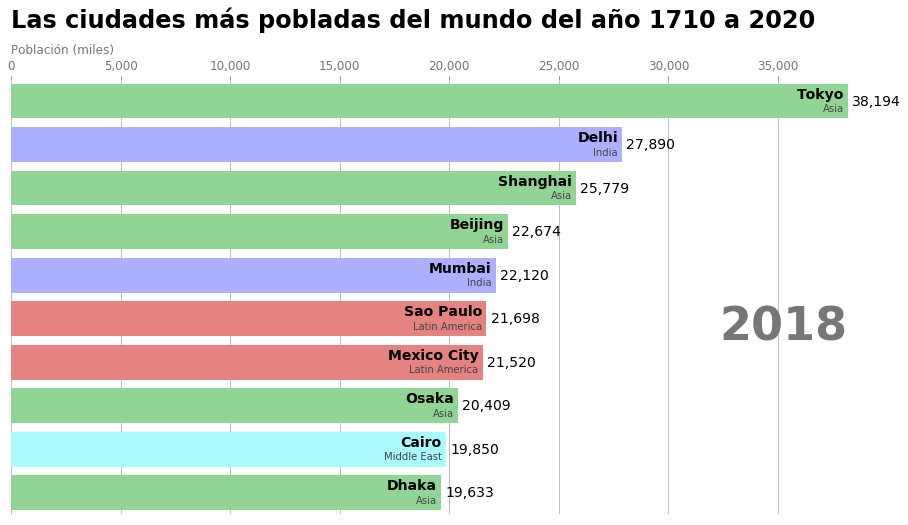

In [51]:
fig, ax = plt.subplots(figsize=(15, 8))
def draw_barchart(year):
    dff = df[df.year==year].sort_values(by='value', ascending=False).head(10)
    dff = dff[::-1]
    ax.clear()
    ax.barh(dff['name'], dff['value'], color=[colors[group_lk[x]] for x in dff['name']])
    dx = dff['value'].max() / 200
    for i, (value, name) in enumerate(zip(dff['value'], dff['name'])):
        ax.text(value-dx, i,     name,           size=14, weight=600, ha='right', va='bottom')
        ax.text(value-dx, i-.25, group_lk[name], size=10, color='#444444', ha='right', va='baseline')
        ax.text(value+dx, i,     f'{value:,.0f}',  size=14, ha='left',  va='center')
    # ... polished styles
    ax.text(1, 0.4, year, transform=ax.transAxes, color='#777777', size=46, ha='right', weight=800)
    ax.text(0, 1.06, 'Población (miles)', transform=ax.transAxes, size=12, color='#777777')
    ax.xaxis.set_major_formatter(ticker.StrMethodFormatter('{x:,.0f}'))
    ax.xaxis.set_ticks_position('top')
    ax.tick_params(axis='x', colors='#777777', labelsize=12)
    ax.set_yticks([])
    ax.margins(0, 0.01)
    ax.grid(which='major', axis='x', linestyle='-')
    ax.set_axisbelow(True)
    ax.text(0, 1.12, 'Las ciudades más pobladas del mundo del año 1710 a 2020',
            transform=ax.transAxes, size=24, weight=600, ha='left')
    plt.box(False)
    
draw_barchart(2018)

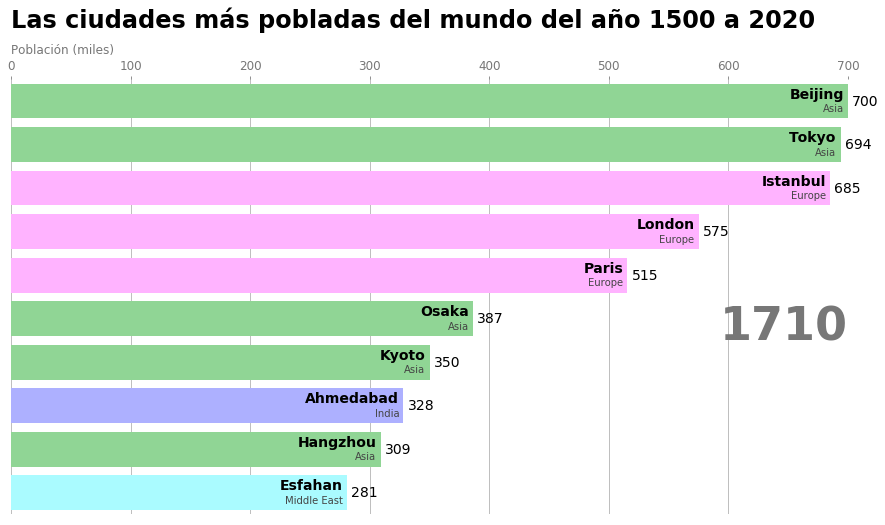

In [50]:
import matplotlib.animation as animation
from IPython.display import HTML

fig, ax = plt.subplots(figsize=(15, 8))
animator = animation.FuncAnimation(fig, draw_barchart, frames=range(1710, 2019))
HTML(animator.to_jshtml()) 
# or use animator.to_html5_video() or animator.save()